# Integration of myofiber single-cell and single-nuclei data

In [119]:
import sys

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

import scanpy as sc
import scvi

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

from datetime import date
today = str(date.today())

import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'pdf')

%cd /nfs/team205/vk8/processed_data/muscle/data_v3

results = '/nfs/team205/vk8/processed_data/muscle/data_v3/updated_icm_snuclei'

/nfs/team205/vk8/processed_data/muscle/data_v3


In [59]:
data_folder = '/nfs/team205/vk8/processed_data/muscle/data_v3'

In [2]:
model_folder = '/nfs/team205/vk8/scripts/scvi/Results/scvi_models/'
figures = '/nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1/figures'
tables = '/nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1/tables'

## Import the data

In [3]:
adata_all = sc.read('/nfs/team205/vk8/processed_data/muscle/data_v3/ICM_scell2snuclei_data_2023-05-09.h5ad')

In [5]:
adata =adata_all [adata_all.obs['annotation_level0'].isin(['MF-IIsn(fg)', 'MF-Isn(fg)', 'MF-I', 'MF-Isc(fg)',
       'MF-II', 'MF-IIsc(fg)', 'Specialised MF', 'Hyb']),:].copy()

In [6]:
adata.obs['annotation_level1'].cat.categories

Index(['Hyb', 'MF-I', 'MF-II', 'MF-IIsc(fg)', 'MF-IIsn(fg)', 'MF-Isc(fg)',
       'MF-Isn(fg)', 'MF_type-MYH8+', 'MF_type-RASA4+', 'MTJ', 'NMJ',
       'NMJ_accessory'],
      dtype='object')

In [7]:
adata.obs['annotation_level2'].cat.categories

Index(['Hyb', 'I-FAM', 'I-OTU+TNF+', 'II-FAM', 'II-OTU+TNF+', 'MF-I', 'MF-II',
       'MF-IIsn(fg)', 'MF-Isn(fg)', 'MF_type-MYH8+', 'MF_type-RASA4+',
       'MF_typeI(fg)', 'MF_typeI-TNNT2(fg)', 'MF_typeI-UCHL1(fg)',
       'MF_typeII(fg)', 'MF_typeII-UCHL1(fg)', 'MTJ', 'NMJ', 'NMJ_accessory'],
      dtype='object')

In [8]:
adata.obs['10X_version'].unique()
adata.obs['SampleID'].cat.categories
adata.obs['DonorID'].cat.categories
adata.obs['Sex'].cat.categories

['3'v2', '3'v3', '3'v2/v3']
Categories (3, object): ['3'v2', '3'v3', '3'v2/v3']

Index(['5386STDY7600836', '5386STDY7600837', '5386STDY7600838',
       '5386STDY7600839', '5386STDY7645353', '5386STDY7645354',
       '5386STDY7645355', '5386STDY7796286', '5386STDY7796287',
       '5386STDY7835292', '5386STDY7835293', '5386STDY8047212',
       '5386STDY8090404', '5386STDY8090405', '5386STDY8090406',
       '5386STDY8090407', '5386STDY8493510', '5386STDY8552613',
       '5386STDY8552614', '5386STDY8552709', 'WS_A_SKM9426495',
       'WS_A_SKM9426496', 'WS_A_SKM9426497', 'WS_A_SKM9426498',
       'WS_A_SKM9426499', 'WS_A_SKM9426500', 'WS_A_SKM9426501',
       'WS_A_SKM9426502', 'WS_A_SKM9845425', 'WS_A_SKM9845426',
       'WS_A_SKM9845427', 'WS_A_SKM9845428', 'WS_A_SKM9845429',
       'WS_A_SKM9845430', 'WS_A_SKM10490125', 'WS_A_SKM10490126',
       'WS_A_SKM10490127', 'WS_A_SKM10490128', 'WS_A_SKM10691778',
       'WS_A_SKM10691779', 'mus_SNuc7468111', 'mus_SNuc7468112',
       'mus_SNuc7511880'],
      dtype='object')

Index(['339C', '343B', '362C', '367C', '398B', '411C', '464C', '470BR', '500C',
       '502B', '529C', '566B', '582C', '583B', '591C', '621B', '640C'],
      dtype='object')

Index(['F', 'M'], dtype='object')

In [9]:
adata.obs['SampleID'].value_counts()
adata.obs['batch'].value_counts()

WS_A_SKM9426500     7504
mus_SNuc7468111     6487
5386STDY7645355     5538
5386STDY8552709     5522
WS_A_SKM9426496     5369
5386STDY8552614     4969
WS_A_SKM9426498     4481
WS_A_SKM9426502     4411
5386STDY8552613     4345
WS_A_SKM9426497     4255
WS_A_SKM9426501     4196
5386STDY7600836     3744
5386STDY7600837     3543
WS_A_SKM9426495     2799
5386STDY8090407     2133
WS_A_SKM10490128    2031
WS_A_SKM10490127    1997
5386STDY8090406     1843
WS_A_SKM10490126    1498
WS_A_SKM10691778    1242
5386STDY8493510     1142
WS_A_SKM10490125    1103
WS_A_SKM9845426     1085
WS_A_SKM9845428      773
WS_A_SKM9845425      754
WS_A_SKM9845429      733
WS_A_SKM9845427      707
mus_SNuc7511880      502
WS_A_SKM9845430      476
WS_A_SKM9426499      363
WS_A_SKM10691779     363
mus_SNuc7468112      351
5386STDY7600839      247
5386STDY7600838      199
5386STDY7796287      194
5386STDY7645354      186
5386STDY7796286      183
5386STDY7645353      165
5386STDY8090405       38
5386STDY8090404       27


nuclei    74626
cells     12896
Name: batch, dtype: int64

### The more hv genes you use for the model to fit the better (al long as it fits in a reasonable time)

In [12]:
adata.X.data
adata.layers['counts'].data

array([0.2599318, 0.2599318, 0.2599318, ..., 3.003556 , 3.003556 ,
       3.003556 ], dtype=float32)

array([1., 1., 1., ..., 1., 1., 1.], dtype=float32)

In [13]:
adata_raw = adata.copy()

In [14]:
#adata.layers["counts"] = adata.X.copy()
#sc.pp.normalize_total(adata, target_sum=1e4)
#sc.pp.log1p(adata)
#adata.raw = adata  # keep full dimension safe
sc.pp.highly_variable_genes(
    adata,
    flavor="seurat_v3",
    n_top_genes=10000,
    layer="counts",
    batch_key="batch",
    subset=True)

categorical_covariate_keys=["10X_version", "DonorID"],
    continuous_covariate_keys=["percent_mito"]

In [15]:
scvi.model.SCVI.setup_anndata(adata, layer="counts", batch_key="SampleID", \
                             categorical_covariate_keys=["batch", "10X_version", "Sex", "DonorID"], \
                             continuous_covariate_keys=["percent_mito"])

INFO     Using batches from adata.obs["SampleID"]                                            
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              
INFO     Successfully registered anndata object containing 87522 cells, 10000 vars, 43       
         batches, 1 labels, and 0 proteins. Also registered 4 extra categorical covariates   
         and 1 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


In [16]:
vae = scvi.model.SCVI(adata, n_layers=2, n_latent=30, gene_likelihood="nb")

In [17]:
vae.train()

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 91/91: 100%|██████████| 91/91 [08:51<00:00,  5.84s/it, loss=1.58e+03, v_num=1]


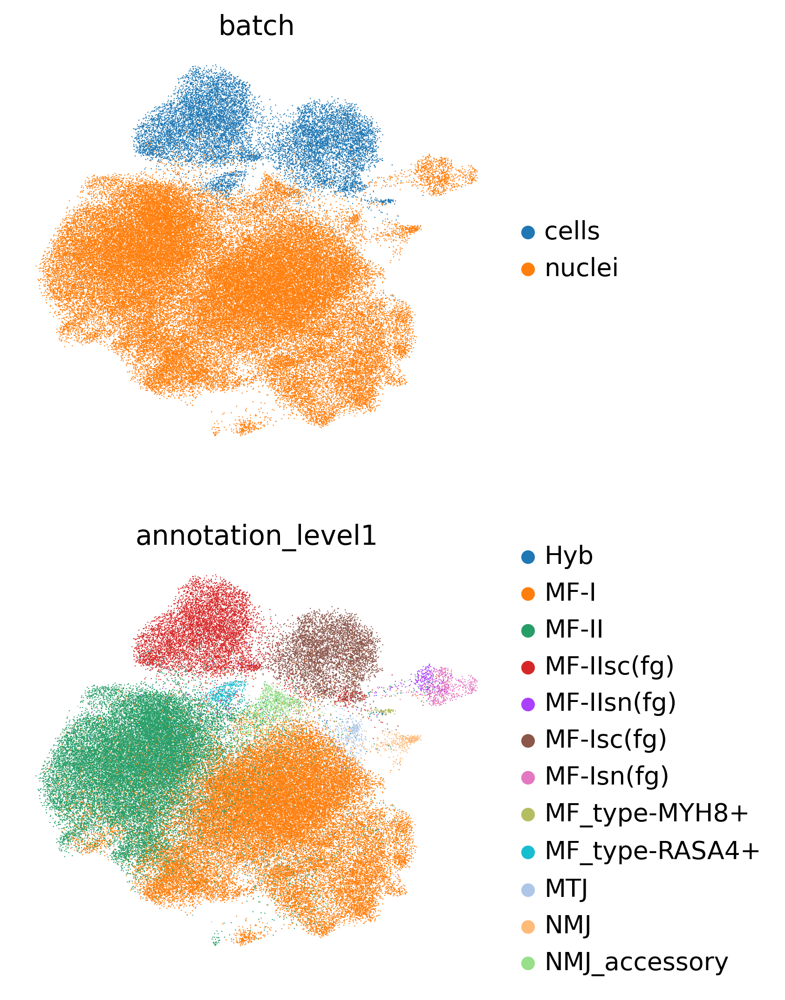

In [18]:
adata.obsm["X_scVI"] = vae.get_latent_representation()
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.leiden(adata)
sc.tl.umap(adata)
sc.pl.umap(
    adata,
    color=["batch", "annotation_level1"],
    frameon=False,
    ncols=1,
)

In [19]:
adata.obsm['X_umap-scvi'] = adata.obsm['X_umap']

In [20]:
adata.obs['scanvi_annotation'] = adata.obs['annotation_level0'].apply(lambda x: 'nan' if x in ['Hyb', 'Specialised MF'] else
                                                                     x)

In [21]:
scvi.model.SCANVI.setup_anndata(adata, layer="counts", batch_key="SampleID", \
                        labels_key = "scanvi_annotation",
                        categorical_covariate_keys=["batch", "10X_version", "Sex", "DonorID"], \
                        continuous_covariate_keys=["percent_mito"])

INFO     Using batches from adata.obs["SampleID"]                                            
INFO     Using labels from adata.obs["scanvi_annotation"]                                    
INFO     Using data from adata.layers["counts"]                                              
INFO     Successfully registered anndata object containing 87522 cells, 10000 vars, 43       
         batches, 7 labels, and 0 proteins. Also registered 4 extra categorical covariates   
         and 1 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


In [22]:
lvae = scvi.model.SCANVI.from_scvi_model(
    vae,
    adata=adata,
    unlabeled_category = 'nan'
)

In [23]:
lvae.train(max_epochs=20, n_samples_per_label=100)

INFO     Training for 20 epochs.                                                             


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 20/20: 100%|██████████| 20/20 [04:05<00:00, 12.29s/it, loss=1.61e+03, v_num=1]


In [24]:
adata.obsm["X_scANVI"] = lvae.get_latent_representation(adata)
sc.pp.neighbors(adata, use_rep="X_scANVI")
sc.tl.umap(adata, min_dist=0.7, spread=1.0)

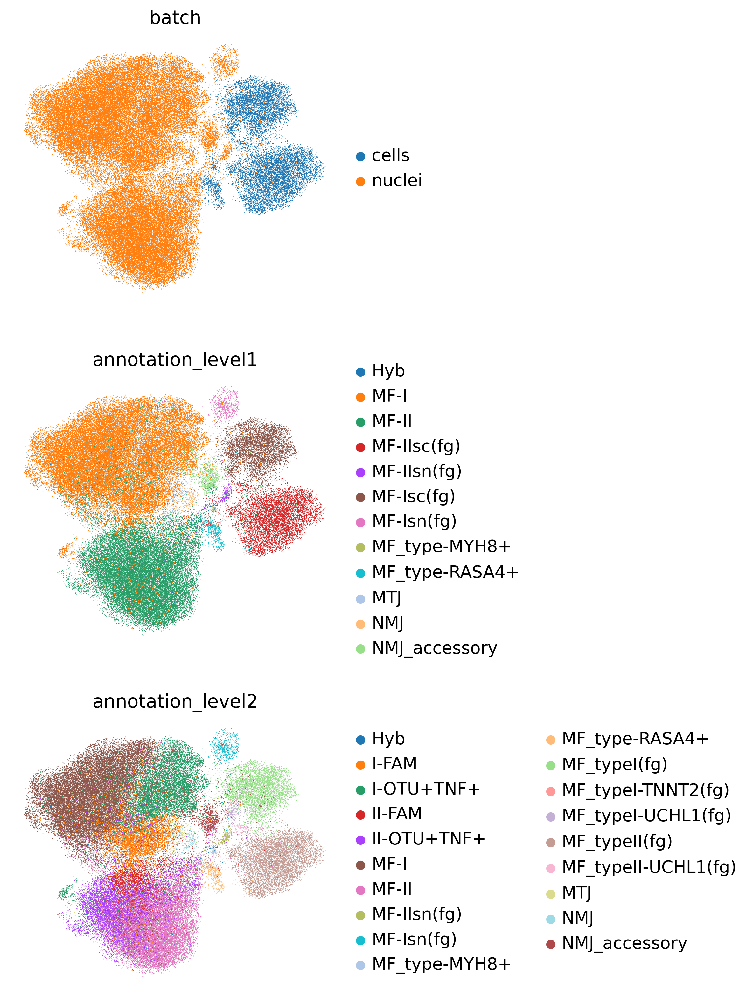

In [25]:
sc.pl.umap(
    adata,
    color=["batch", "annotation_level1", "annotation_level2"],
    frameon=False,
    ncols=1,
)

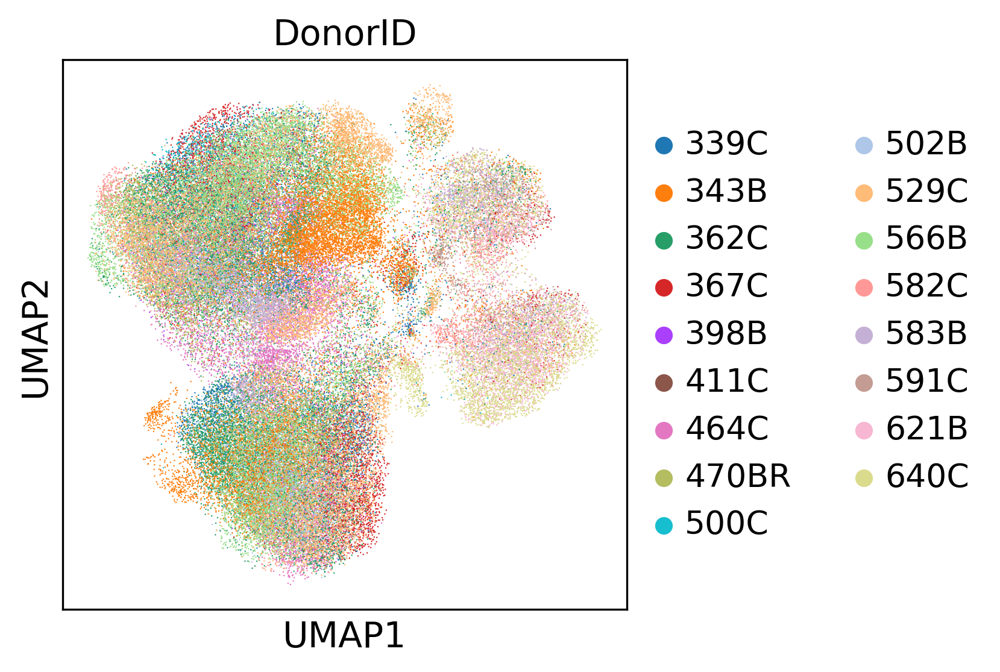

In [26]:
sc.pl.umap(adata, color = ['DonorID'])

In [27]:
adata.obsm['X_umap-scanvi'] = adata.obsm['X_umap']

adata.obsm['X_umap'] = adata.obsm['X_umap-scvi']

adata.obsm['X_umap'] = adata.obsm['X_umap-scanvi']

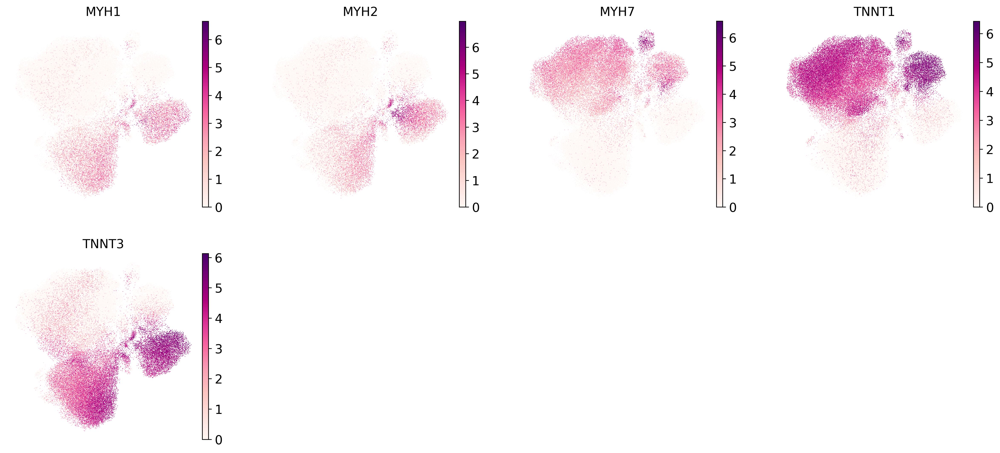

In [28]:
sc.pl.umap(
    adata,
    color=["MYH1", "MYH2", "MYH7", 'TNNT1', 'TNNT3'],
    frameon=False,
)

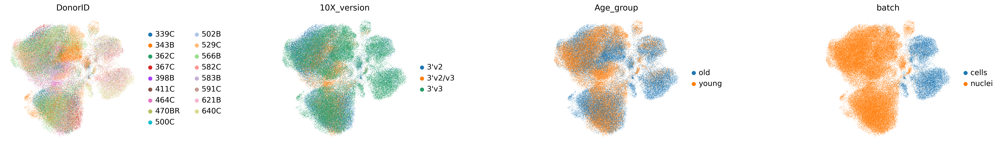

In [29]:
sc.pl.umap(
    adata,
    color=["DonorID","10X_version", "Age_group", "batch"], wspace = 0.8,
    frameon=False,
)

In [33]:
adata_raw.X.data

array([0.2599318, 0.2599318, 0.2599318, ..., 3.003556 , 3.003556 ,
       3.003556 ], dtype=float32)

In [34]:
adata.shape
adata_raw.shape

(87522, 10000)

(87522, 33538)

In [35]:
adata_scvi = sc.AnnData(X = adata_raw.X, obs = adata.obs, var = adata_raw.var, 
                       layers = adata_raw.layers, obsm = adata.obsm.copy(), uns = adata.uns.copy(),
                       obsp = adata.obsp.copy())

In [36]:
adata_scvi

AnnData object with n_obs × n_vars = 87522 × 33538
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X_version', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_level0', 'annotation_level1', 'annotation_level2', 'batch', 'Donor_type', 'BMI', 'Ventilation_cat', 'BMI_num', '_scvi_batch', '_scvi_labels', 'leiden', 'scanvi_annotation'
    var: 'ENSEMBL', 'SYMBOL', 'n_counts-cells', 'n_cells-cells', 'mean-cells', 'std-cells', 'n_counts-nuclei', 'n_cells-nuclei'
    uns: 'batch_colors', 'hvg', '_scvi', 'neighbors', 'leiden', 'umap', 'annotation_level1_colors', 'annotation_level2_colors', 'DonorID_colors', '10X_version_colors', 'Age_group_colors'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categ

In [38]:
adata_scvi.obs['batch2'] = adata_scvi.obs['batch'].copy()

In [40]:
adata_scvi.obs['batch2'].cat.categories = ['Myofiber', 'Myonuclei']

In [47]:
figures

'/nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1/figures'

In [60]:
adata_scvi.write(f'{data_folder}/Myofiber2myonuclei_scvi_integration_{today}.h5ad')

In [70]:
vae.save(f'{model_folder}/ICM_myonuclei2myofiber_scvi1_{today}', save_anndata=True)

In [107]:
lvae.save(f'{model_folder}/ICM_myonuclei2myofiber_scanvi1_{today}', save_anndata=True)

In [63]:
myofiber_markers2 = ['TNNT1', 'MYH7', 'TNNT3', 'MYH1', 'MYH2', 
                 "CKM", "MB", "COX6C", # cytoplasmic populations
                'FAM189A2', 'KHDRBS3','NAMPT', 'SOCS3', 'STAT3', # FAM189A2 population
                'OTUD1','CREB5', 'ATF3', 'XIRP1','ENAH', 'FLNC', 'DNAJA4', #'BDNF',  # 'NRAP', 'ANKRD1', 'XIRP2',  # OTUD1 population 
                    'TNFRSF12A', 'THBD','JUNB', 'JDP2', 'ERCC1','GADD45A','ANXA5',
                   'MUSK', 'ACHE', 'VMO1', 'PLCB4',  #NMJ
                    'NCAM1', 'MAML2', 'SNX7', # MTJ
                 'SORBS2', 'EFNA5', 'BMPR1B', 'GRIA2', 'STYK1', # SORBS2 population
                   'ACTC1', 'UCHL1', 'RGCC', 'MLLT11', # UCHL1 population
                    'MYOG', 'TNNT2', # TNNT2 population
                     'CDKN1A', 'ADIRF', 'SAA1',  'MYH8', # MYH8 populations 'MYOD1',
                   'FLCN', 'FNIP1', 'RASA4']

### Generate figures

In [50]:
%cd /nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1

/nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1


In [71]:
adata_scvi.obs['annotation_level0_fig']= adata_scvi.obs['annotation_level0'].apply(lambda x:
                                      'Other nuclei' if x in ['Specialised MF', 'Hyb'] else x)

In [73]:
adata_scvi.obs['annotation_level0_fig']=adata_scvi.obs['annotation_level0_fig'].astype('category')

In [76]:
adata_scvi.obs['annotation_level0_fig'] = adata_scvi.obs['annotation_level0_fig'].cat.reorder_categories(['MF-I', 'MF-Isn(fg)','MF-Isc(fg)',
                                                                'MF-II', 'MF-IIsn(fg)','MF-IIsc(fg)',
                                                               'Other nuclei']).copy()

In [102]:
adata_scvi.obs['batch2'] = adata_scvi.obs['batch2'].cat.reorder_categories(['Myonuclei', 'Myofiber'])

In [87]:
color_anno0 =  ['1F77B4','FF7F0E','279E68', 'D62728', 'AA40FC', '8C564B', 'D3D3D3']

In [97]:
adata_scvi.uns['annotation_level0_fig_colors'] =  ['#1F77B4','#FF7F0E','#279E68', '#D62728', '#AA40FC', 
                                                   '#8C564B', '#D3D3D3']

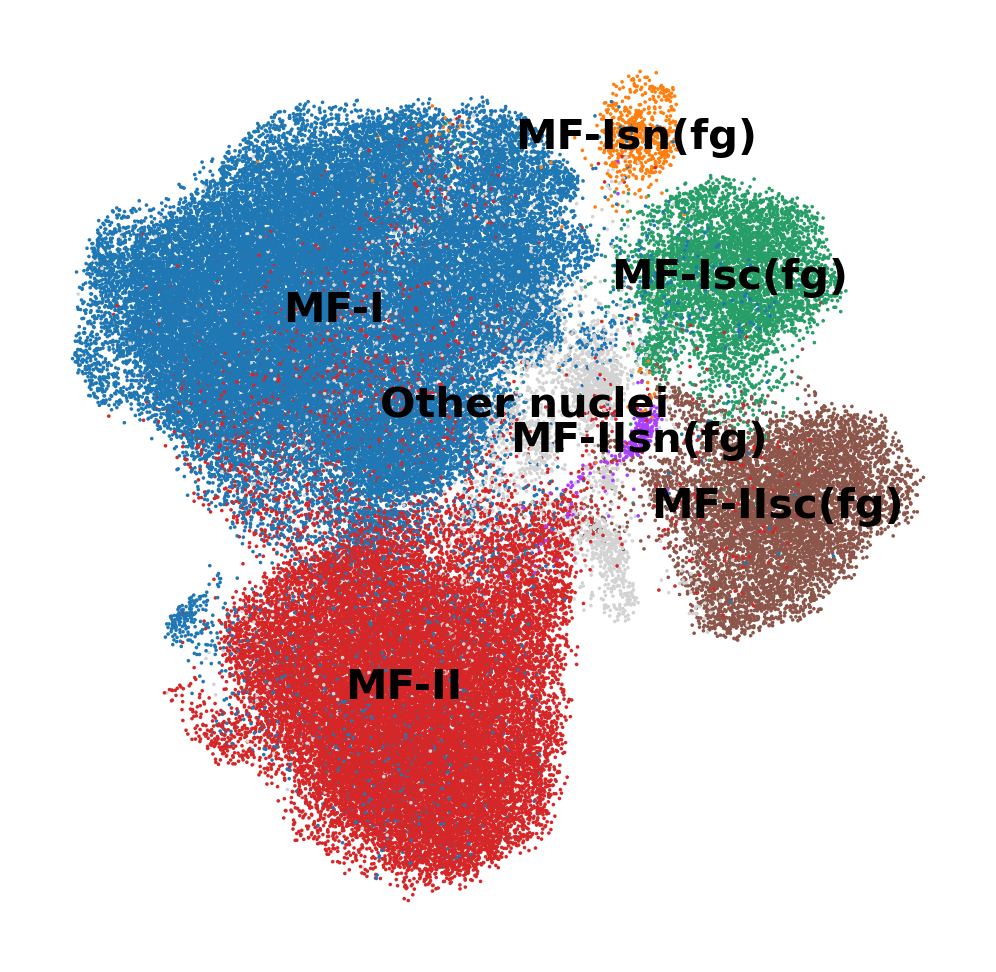

In [120]:
sc.pl.umap(adata_scvi, color = 'annotation_level0_fig', frameon = False, legend_loc = "on data", legend_fontsize = 10,
           title = [''], s = 3, save = f"SKM_myofiber_cell2nuclei_coarse_{today}.pdf")

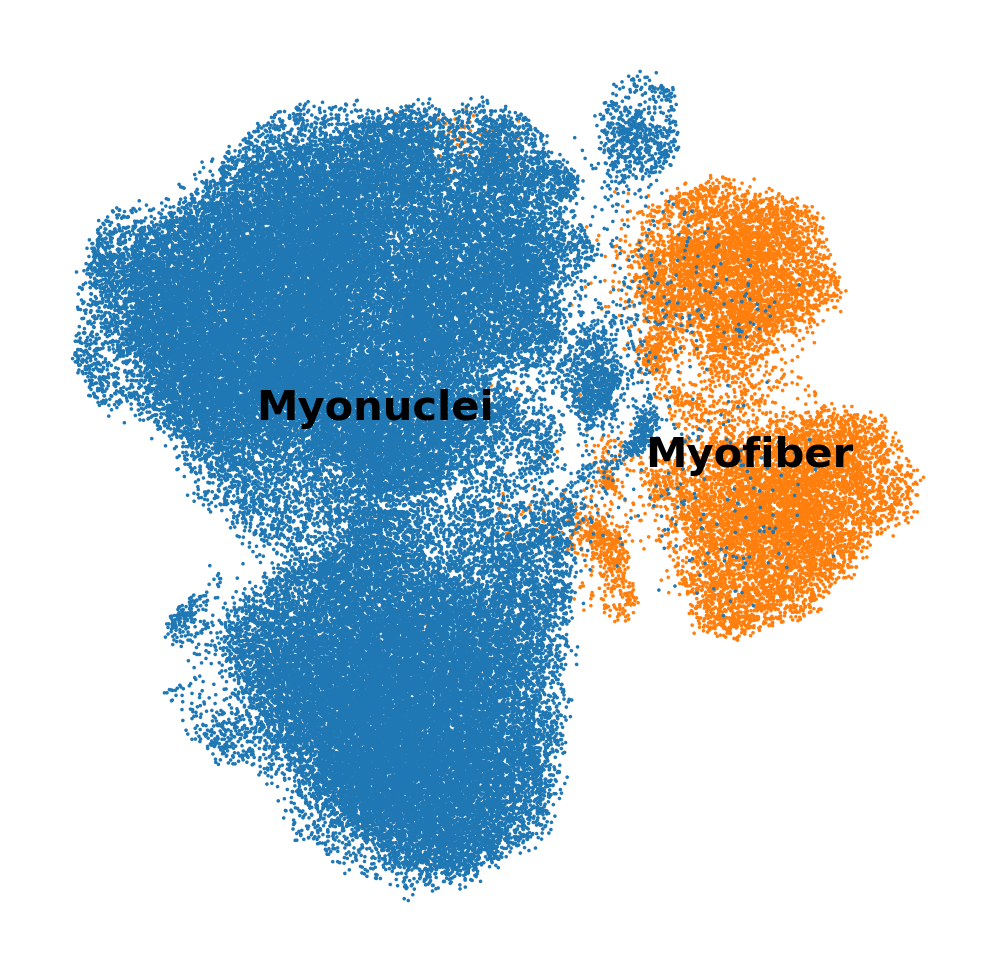

In [121]:
sc.pl.umap(adata_scvi, color = 'batch2', frameon = False, legend_loc = "on data", legend_fontsize = 10,
           title = [''], s = 3, save = f"SKM_myofiber_cell2nuclei_batch_{today}.pdf")

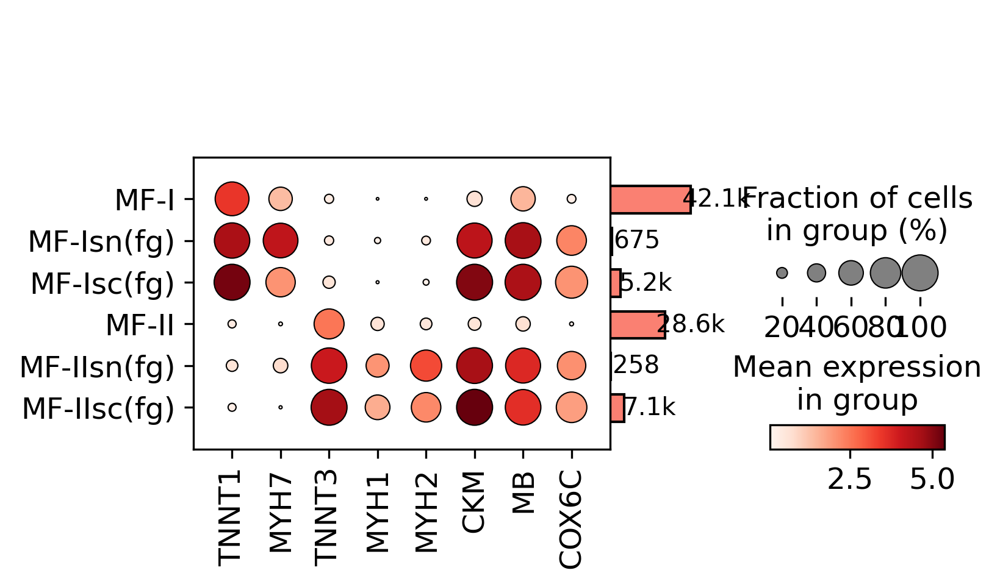

In [84]:
dp = sc.pl.dotplot(adata_scvi[adata_scvi.obs['annotation_level0_fig']!='Other nuclei', :].copy(), var_names = ['TNNT1', 'MYH7', 'TNNT3', 'MYH1', 'MYH2', 
                 "CKM", "MB", "COX6C"], save = 'SKM_myofiber_cell2nuclei_coarse_'+today+ '.pdf', 
              groupby = "annotation_level0_fig", return_fig=True)

dp = dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5, cmap = "Reds")
dp.savefig(f"{figures}/dotplot_SKM_myofiber_cell2nuclei_coarse_{today}.pdf")

In [61]:
adata_scvi.obs['annotation_level2'] = adata_scvi.obs['annotation_level2'].cat.reorder_categories(new_categories =
 ['MF-I', 'MF-II', 'Hyb','MF-Isn(fg)', 'MF-IIsn(fg)', 'I-FAM', 'II-FAM',
 'I-OTU+TNF+', 'II-OTU+TNF+', 'NMJ', 'MTJ', 'NMJ_accessory', 
 'MF_typeI(fg)', 'MF_typeII(fg)', 'MF_typeI-UCHL1(fg)', 'MF_typeII-UCHL1(fg)',
 'MF_typeI-TNNT2(fg)', 'MF_type-MYH8+', 'MF_type-RASA4+']).copy()

In [65]:
adata_scvi.obs['annotation_level2'].cat.categories = [
    'MF-I', 'MF-II', 'Hyb','MF-Isn(fg)', 'MF-IIsn(fg)', 
    'I-FAM', 'II-FAM', 'I-OTU+TNF+', 'II-OTU+TNF+', 
    'NMJ', 'MTJ', 'NMJ_accessory', 
    'MF-Isc(fg)', 'MF-IIsc(fg)', 'I-UCH(fg)', 'II-UCH(fg)','TNNT2+(fg)', 'MYH8+', 'RASA4+']

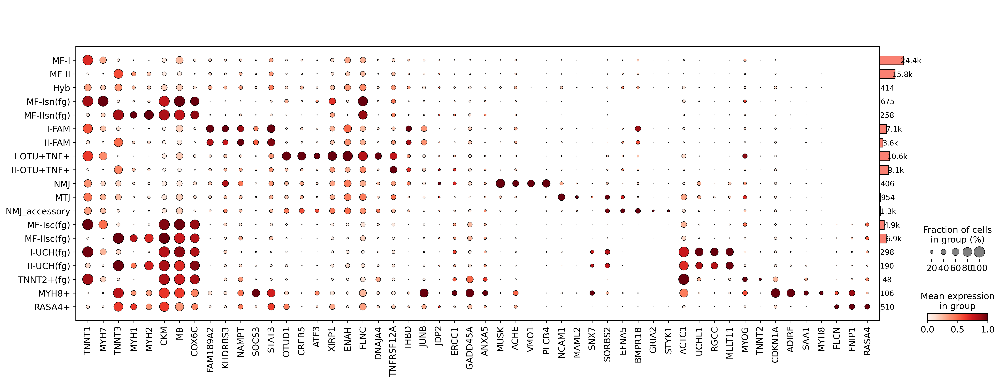

In [104]:
dp = sc.pl.dotplot(adata_scvi, var_names = myofiber_markers2, save = 'SKM_myofiber_cell2nuclei_'+today+ '.pdf', 
              groupby = "annotation_level2", standard_scale = 'var', return_fig = True)

dp = dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5, cmap = "Reds")
dp.savefig(f"{figures}/dotplot_SKM_myofiber_cell2nuclei_fine_{today}.pdf")

In [118]:
adata_scvi.write(f'{data_folder}/Myofiber2myonuclei_scvi_integration_mod_{today}.h5ad')

## Run DE analysis

In [108]:
def scvi_markers(vae, cluster, n_markers=5):
    results = {}
    de_df = vae.differential_expression(
    groupby=cluster)
    de_df['cluster'] = [i.replace(" vs Rest","") for i in de_df['comparison']]
    de_df.head()
    markers = {}
    cats = adata.obs[cluster].cat.categories
    for i, c in enumerate(cats):
        cid = "{} vs Rest".format(c)
        cell_type_df = de_df.loc[de_df.comparison == cid]
        cell_type_df = cell_type_df[cell_type_df.lfc_mean > 0]
        cell_type_df = cell_type_df[cell_type_df["bayes_factor"] > 3]
        cell_type_df = cell_type_df[cell_type_df["non_zeros_proportion1"] > 0.1]
        markers[c] = cell_type_df.index.tolist()[:n_markers]
    results['de_df'] = de_df
    results['markers'] = markers
    #print(results)
    return(results)

In [109]:
de_adata = scvi_markers(vae = lvae, cluster = "annotation_level2")

DE...: 100%|██████████| 19/19 [03:56<00:00, 12.45s/it]


In [115]:
sc.tl.dendrogram(lvae.adata, groupby="annotation_level2", use_rep="X_scVI")

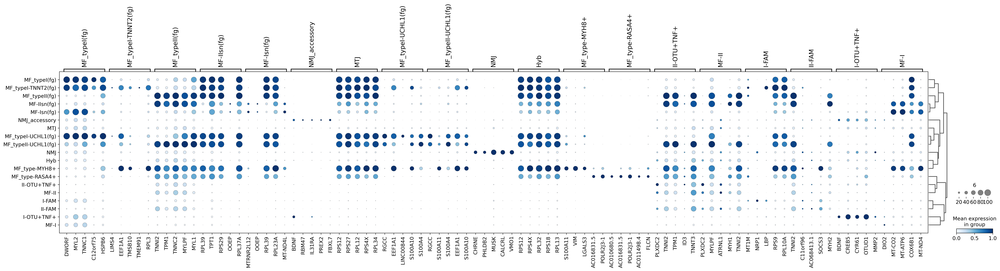

In [116]:
sc.pl.dotplot(
    lvae.adata,
    de_adata['markers'],
    groupby="annotation_level2",
    dendrogram=True,
    color_map="Blues",
    var_group_rotation = 90,
    swap_axes=False,
    use_raw=False,
    standard_scale="var", size_title = 6
)

In [102]:
de_adata['de_df'].to_csv(f'{myonuclei_res_folder}SKM_myonuclei2myofiber_de_ctype_merged_lvae_{today}.csv')